### NB: Requirements!
Install the jupyter extension for plotly to be able to see the figures:
    
```
jupyter labextension install jupyterlab-plotly
```

Docker/your system will also need to have FFmpeg to be able to run scikit-video. On Ubuntu you can install it by running:

```
sudo apt install ffmpeg
```

In [2]:
from scipy.io import loadmat
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.offline as pyo
import plotly.graph_objects as go
from ipywidgets import Video
import skimage.io as skim_io
import skvideo.io as skvid_io
import ffmpeg

In [2]:
%matplotlib widget
%load_ext autoreload
%autoreload 2

In [3]:
pyo.init_notebook_mode()

In [4]:
data_after_CNMF_E = loadmat('data/concat_may_NoRMCorre_results.mat')
data_after_CNMF_E = data_after_CNMF_E['results']

In [5]:
fluorescence_traces = np.array(data_after_CNMF_E['C'][0][0])
fluorescence_traces.shape

(69, 21414)

In [6]:
vmaxes= [100, 50, 40, 30, 25, 20]
for (i,vmax) in enumerate(vmaxes):
    plt.figure(i)
    plt.figure(i).canvas.set_window_title('Vmax: %s' % vmax) 
    sns.heatmap(fluorescence_traces, center=1, vmax=vmax)
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [4]:
def display_figure(figure_settings):
    figure = go.Figure(figure_settings)
    figure.show()
    return figure

def play_and_pause_buttons():
    layout = [{
        "type":"buttons",
        "buttons":[
            {
                "label": "Play",
                "method":"animate",
                "args": [None,{"frame": {"duration": 50, "redraw": True},
                               "fromcurrent": True,
                               "mode": "immediate",
                               "transition": {"duration": 0}}]
            },
            {
                "label": "Pause",
                "method":"animate",
                "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                  "mode": "immediate",
                                  "transition": {"duration": 0}}]
            }
        ]
    }]
    return layout
    
def animated_linechart(data, layout={}):
    figure_settings = {
        "data": [],
        "layout": {},
        "frames": []
    }
    x_axis = list(range(data.shape[0]))
    y_axis = list(data)
    frames = []
    for frame in range(0,len(x_axis),50):
        x_axis_frame = np.arange(frame)
        y_axis_frame = data[0:frame]
        curr_frame = go.Frame(data = [go.Scatter(x=x_axis_frame , y= y_axis_frame, mode="lines")])
        frames.append(curr_frame)
    
    figure_settings["layout"]["xaxis"] = {"title": "time (ms)",
                                          "range":[0,len(x_axis)]}
    figure_settings["layout"]["yaxis"] = {"title": "intensity of signal (value??)",
                                          "range":[0,max(y_axis)]}
    figure_settings["data"] = [go.Scatter(x = x_axis, y = y_axis, mode="lines")]
    figure_settings["layout"] = layout
    figure_settings["layout"]["updatemenus"] = play_and_pause_buttons()
    figure_settings["frames"] = frames
    display_figure(figure_settings)

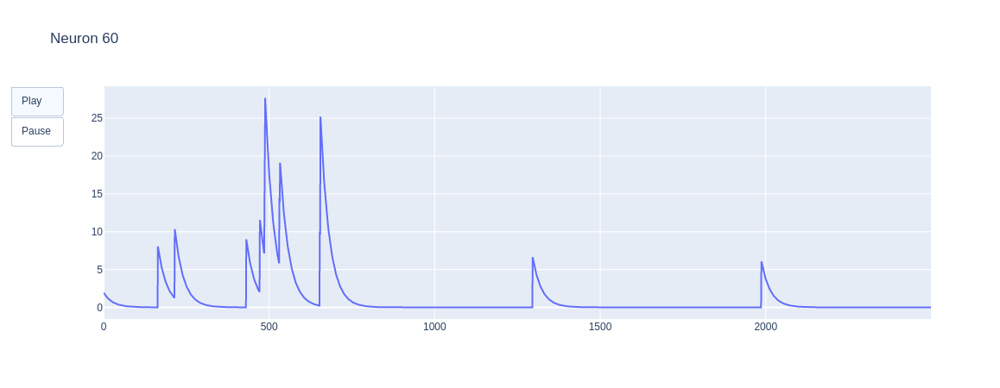

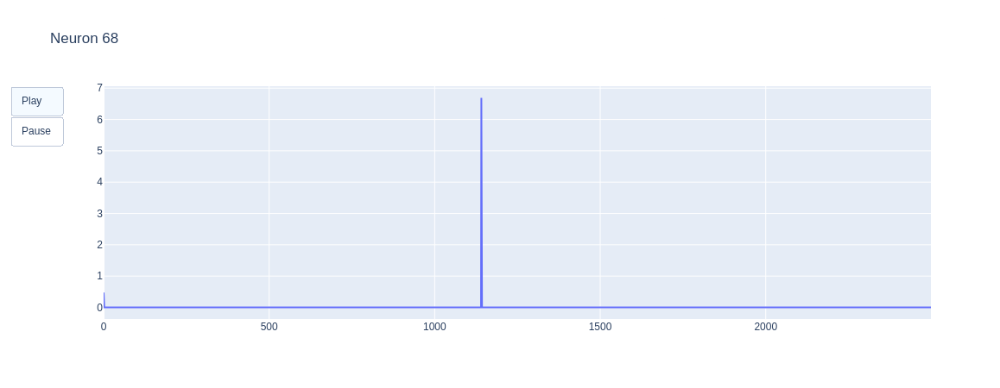

In [9]:
data_after_CNMF_E = loadmat('data/concat_may_NoRMCorre_results.mat')
data_after_CNMF_E = data_after_CNMF_E['results']
fluorescence_traces = np.array(data_after_CNMF_E['C'][0][0])

layout = {}
for i in [60,68]:  #range(0,50,9):
    layout["title"] =  "Neuron " + str(i)
    trace = fluorescence_traces[i,0:2500]
    animated_linechart(data=trace, layout=layout)

In [10]:
video = Video.from_file("data/nyan_cat.mp4")
video

Video(value=b'\x00\x00\x00\x18ftypmp42\x00\x00\x00\x00isommp42\x00\x01\r\xbamoov\x00\x00\x00lmvhd\x00\x00\x00\…

In [2]:
tiff_data = skim_io.imread("data/concat_may_NoRMCorre.tif")

NameError: name 'skim_io' is not defined

In [11]:
print(type(tiff_data), tiff_data.shape)

<class 'numpy.ndarray'> (21414, 240, 376)


In [33]:
import time
import cv2
frame_height = tiff_data.shape[1]
frame_width = tiff_data.shape[2]

print(tiff_data.shape)

# fourcc = cv2.VideoWriter_fourcc(*'MP4V')
fourcc = -1 #0x00000021

video_writer = cv2.VideoWriter("output.mp4", fourcc, 20, (frame_width, frame_height))
start_time = time.time()
for frame in tiff_data:
    video_writer.write(frame)
cv2.destroyAllWindows()
video_writer.release()
print("----for loop took %s seconds" % (time.time()-start_time))

# video_writer_generator = cv2.VideoWriter('output_generator.ogg', fourcc, 20, (frame_width, frame_height))
# start_time = time.time()
# for frame in generatorify(tiff_data):
#     video_writer_generator.write(frame)
# video_writer_generator.release()
# cv2.destroyAllWindows()
# print("----generator took %s seconds" % (time.time()-start_time))

# Video.from_file("output.mp4")


(21414, 240, 376)
----for loop took 0.011849164962768555 seconds


In [6]:
import cv2
import numpy as np

# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('data/nyan_cat.mp4')

# Check if camera opened successfully
if (cap.isOpened()== False): 
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:

    # Display the resulting frame
    cv2.imshow('Frame',frame)

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  # Break the loop
  else: 
    break

# When everything done, release the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()


KeyboardInterrupt: 

In [7]:
cap.release()

# Closes all the frames
cv2.destroyAllWindows()

In [25]:
video_writer.release()

In [14]:
# # THE BELOW DOESNT WORK (IN JUPYTER)

# stack=tiff_data # Read the numpy matrix with images in the rows
# image=stack[0] # this is the size of my pictures
# im=plt.imshow(image)
# for image in stack:
#     im.set_data(image)
#     plt.pause(0.000002)
# plt.show()

In [1]:
from scipy.io import loadmat
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.offline as pyo
import plotly.graph_objects as go
from ipywidgets import Video
import skimage.io as skim_io
import skvideo.io as skvid_io
import ffmpeg

tiff_data = skim_io.imread("data/concat_may_NoRMCorre.tif")

In [2]:
print(type(tiff_data), tiff_data.shape)
print(tiff_data[0])
print("max:", np.amax(tiff_data))

<class 'numpy.ndarray'> (21414, 240, 376)
[[22 16 22 ...  4  0  3]
 [23 19 19 ...  4  0  3]
 [25 19 21 ...  2  0  4]
 ...
 [ 6  3  6 ...  2  1  3]
 [ 4  4  4 ...  4  0  2]
 [ 4  4  4 ...  1  1  3]]
max: 255


In [3]:
def generatorify(tiff_data, skip_rate=1):
    if skip_rate>1:
        count = 0
        for image in tiff_data:
            if count % skip_rate == 0:
                yield image
            count += 1
    else:
        for image in tiff_data:
            yield image

In [18]:
frames = []
for image in generatorify(tiff_data, skip_rate=1000):
    frames.append(image)
len(frames)

22

done!


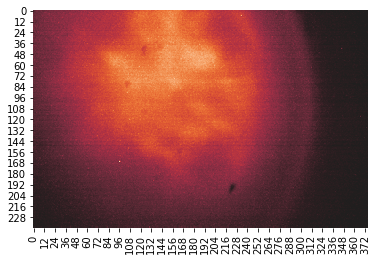

In [15]:
## THIS WORKS, BUT IS REALLY SLOW (because of seaborne?)

from matplotlib import animation

data = tiff_data
fig = plt.figure()
def init():
      sns.heatmap(data[0,:,:], cbar=False, center=1)

def animate(i):
    frame = data[i,:,:]
    sns.heatmap(frame, cbar=False, center=1)

anim = animation.FuncAnimation(fig, animate, init_func=init, repeat = False)
anim.save(filename="animation_new.mp4", writer='ffmpeg')
print("done!")

In [4]:
# This seems to work!

import time
from skvideo import io as skvid_io
start_time = time.time()
skvid_io.vwrite("outputvideo.mov", tiff_data)
print("--- this took %s seconds ---" % (time.time() - start_time))

--- this took 22.161194562911987 seconds ---


In [4]:
# for some reason Jupyter doesn't want to play it though..
Video.from_file("outputvideo.mp4")

Video(value=b'\x00\x00\x00 ftypisom\x00\x00\x02\x00isomiso2avc1mp41\x00\x00\x00\x08free\x00+\xd3\x05mdat\x00\x…

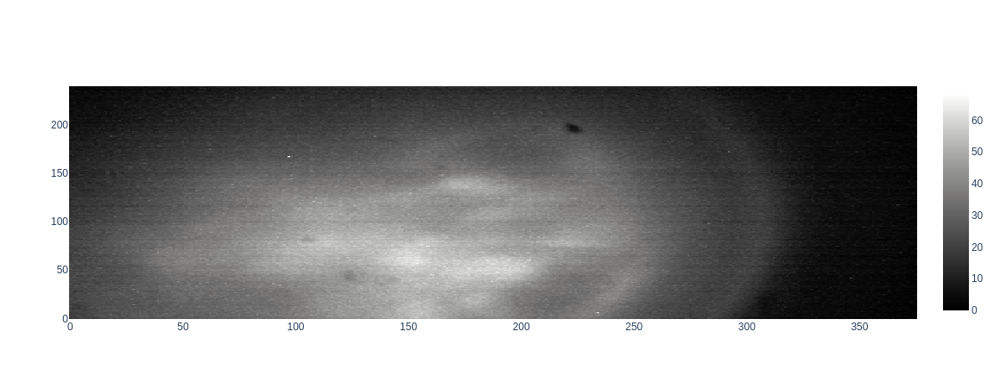

In [5]:
#Heatmap in Plotly

import chart_studio.plotly as py
import plotly.graph_objs as go

# for i in range(0,1000,100):
#     data = tiff_data[i]
#     fig = go.Figure(data=go.Heatmap(z=data,colorscale='gray'))
#     fig.show()
data = tiff_data[0]
fig = go.Figure(data=go.Heatmap(z=data,colorscale='gray'))
fig.show()

In [6]:
tiff_data.shape

(21414, 240, 376)

In [9]:
def display_figure(figure_settings):
    figure = go.Figure(figure_settings)
    figure.show()
    
    return figure

def play_and_pause_buttons():
    layout = [{
        "type":"buttons",
        "buttons":[
            {
                "args": [None, {"frame": {"duration": 400, "redraw": True},
                                "fromcurrent": True, "transition": {"duration": 0}}],
                "label": "Play",
                "method": "animate"
            },
            {
                "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                  "mode": "immediate",
                                  "transition": {"duration": 0}}],
                "label": "Pause",
                "method": "animate"
            }
        ]
    }]
    
    return layout


def generatorify(tiff_data, skip_rate=1):
    count = 0
    for image in tiff_data:
        if count % skip_rate == 0:
            yield image
        count += 1
        

def animated_heatmap(data, layout={}, skip_rate=1):
    figure_settings = {
        "data": [],
        "layout": {},
        "frames": []
    }
    figure_settings["layout"] = layout
        
    figure_settings["layout"]["xaxis"] = {"range":[0,data.shape[1]]}
    figure_settings["layout"]["yaxis"] = {"range":[0,data.shape[2]]}
    
    frames = []        
    for image in generatorify(data, skip_rate=skip_rate):
        curr_frame = go.Frame(data = [go.Heatmap(z = image, colorscale='gray')])
        frames.append(curr_frame)
    print(type(frames[0]), len(frames))
        
    figure_settings["data"] = [go.Image(z = data[0], colorscale='gray')]
    figure_settings["layout"]["updatemenus"] = play_and_pause_buttons()
    figure_settings["frames"] = frames
    
    heatmap = display_figure(figure_settings)
    
    return (frames, heatmap)

In [ ]:
import plotly.graph_objects as go
import skimage.io as skim_io
import skvideo.io as skvid_io
import ffmpeg

tiff_data = skim_io.imread("data/concat_may_NoRMCorre.tif")

In [ ]:
data_subset = tiff_data[0:1000]

In [ ]:
layout = {}
layout["title"] =  "Animation!!!"
frames = []
(frames, heatmap) = animated_heatmap(data=data_subset, layout=layout, skip_rate=50)

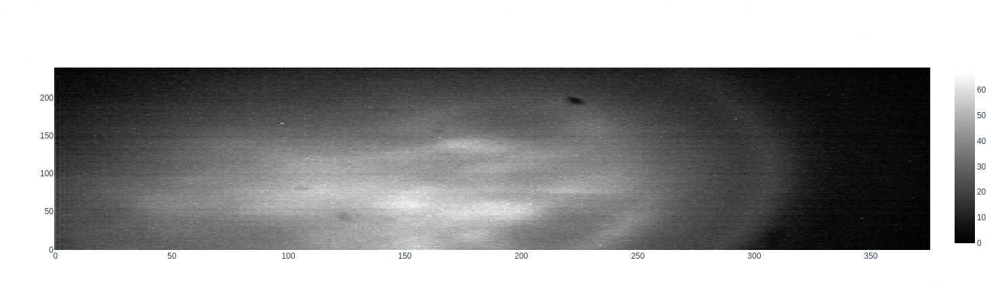

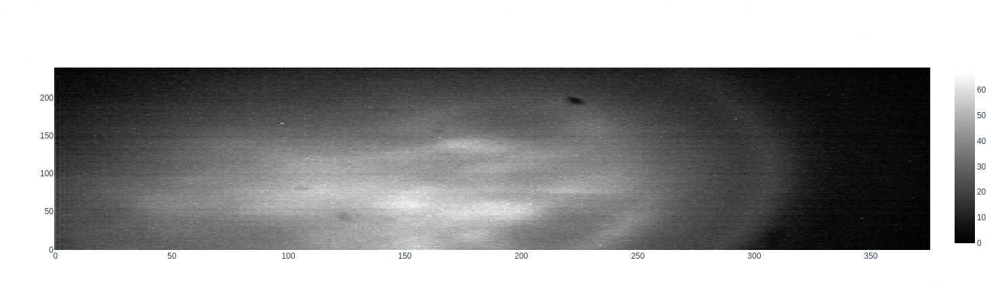

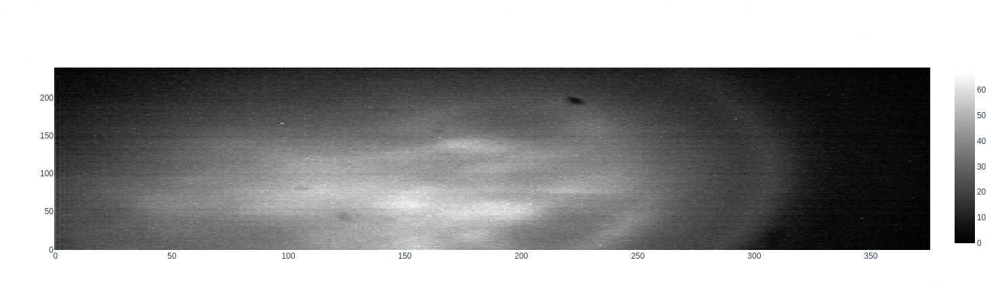

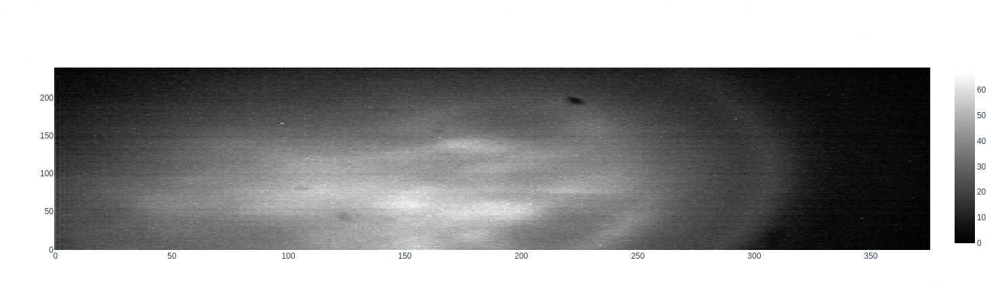

In [5]:
for frame in frames:
    fig = go.Figure(frames[0]['data'][0])
    fig.show()

In [67]:
# Animation in Plotly

import time
import numpy as np

data=[dict(type='heatmap',
           xsrc=grid.get_column_reference('x'),
           ysrc=grid.get_column_reference('y'),
           zsrc=grid.get_column_reference('z1'),
           zmin=0,
           zmax=zvmax[6],
           zsmooth='best',
           colorscale='gray',
           colorbar=dict(thickness=20, ticklen=4))]

title='Contour plot for bivariate normal distribution'+\
'<br> N(m=[0,0], sigma=[1,1], rho in (-1, 1))'

layout = dict(title=title,
              autosize=False,
              height=600,
              width=600,
              hovermode='closest',
              xaxis=dict(range=[-3, 3], autorange=False),
              yaxis=dict(range=[-3, 3], autorange=False),
              showlegend=False,
              updatemenus=[dict(type='buttons', showactive=False,
                                y=1, x=-0.05, xanchor='right',
                                yanchor='top', pad=dict(t=0, r=10),
                                buttons=[dict(label='Play',
                                              method='animate',
                                              args=[None,
                                                    dict(frame=dict(duration=100,
                                                                    redraw=True),
                                                    transition=dict(duration=0),
                                                    fromcurrent=True,
                                                    mode='immediate')])])])

frames=[dict(data=[dict(zsrc=grid.get_column_reference('z{}'.format(k + 1)),
                        zmax=zvmax[k])],
                        traces=[0],
                        name='frame{}'.format(k),
                        ) for k in range(len(correls))]


fig=dict(data=data, layout=layout, frames=frames)
display_figure(figure_settings=fig)
# py.icreate_animations(fig, filename='animheatmap'+str(time.time()))

ValueError: Invalid property specified for object of type plotly.graph_objs.Scatter: 'zsrc'

Did you mean "rsrc"?

    Valid properties:
        cliponaxis
            Determines whether or not markers and text nodes are
            clipped about the subplot axes. To show markers and
            text nodes above axis lines and tick labels, make sure
            to set `xaxis.layer` and `yaxis.layer` to *below
            traces*.
        connectgaps
            Determines whether or not gaps (i.e. {nan} or missing
            values) in the provided data arrays are connected.
        customdata
            Assigns extra data each datum. This may be useful when
            listening to hover, click and selection events. Note
            that, "scatter" traces also appends customdata items in
            the markers DOM elements
        customdatasrc
            Sets the source reference on Chart Studio Cloud for
            customdata .
        dx
            Sets the x coordinate step. See `x0` for more info.
        dy
            Sets the y coordinate step. See `y0` for more info.
        error_x
            :class:`plotly.graph_objects.scatter.ErrorX` instance
            or dict with compatible properties
        error_y
            :class:`plotly.graph_objects.scatter.ErrorY` instance
            or dict with compatible properties
        fill
            Sets the area to fill with a solid color. Defaults to
            "none" unless this trace is stacked, then it gets
            "tonexty" ("tonextx") if `orientation` is "v" ("h") Use
            with `fillcolor` if not "none". "tozerox" and "tozeroy"
            fill to x=0 and y=0 respectively. "tonextx" and
            "tonexty" fill between the endpoints of this trace and
            the endpoints of the trace before it, connecting those
            endpoints with straight lines (to make a stacked area
            graph); if there is no trace before it, they behave
            like "tozerox" and "tozeroy". "toself" connects the
            endpoints of the trace (or each segment of the trace if
            it has gaps) into a closed shape. "tonext" fills the
            space between two traces if one completely encloses the
            other (eg consecutive contour lines), and behaves like
            "toself" if there is no trace before it. "tonext"
            should not be used if one trace does not enclose the
            other. Traces in a `stackgroup` will only fill to (or
            be filled to) other traces in the same group. With
            multiple `stackgroup`s or some traces stacked and some
            not, if fill-linked traces are not already consecutive,
            the later ones will be pushed down in the drawing
            order.
        fillcolor
            Sets the fill color. Defaults to a half-transparent
            variant of the line color, marker color, or marker line
            color, whichever is available.
        groupnorm
            Only relevant when `stackgroup` is used, and only the
            first `groupnorm` found in the `stackgroup` will be
            used - including if `visible` is "legendonly" but not
            if it is `false`. Sets the normalization for the sum of
            this `stackgroup`. With "fraction", the value of each
            trace at each location is divided by the sum of all
            trace values at that location. "percent" is the same
            but multiplied by 100 to show percentages. If there are
            multiple subplots, or multiple `stackgroup`s on one
            subplot, each will be normalized within its own set.
        hoverinfo
            Determines which trace information appear on hover. If
            `none` or `skip` are set, no information is displayed
            upon hovering. But, if `none` is set, click and hover
            events are still fired.
        hoverinfosrc
            Sets the source reference on Chart Studio Cloud for
            hoverinfo .
        hoverlabel
            :class:`plotly.graph_objects.scatter.Hoverlabel`
            instance or dict with compatible properties
        hoveron
            Do the hover effects highlight individual points
            (markers or line points) or do they highlight filled
            regions? If the fill is "toself" or "tonext" and there
            are no markers or text, then the default is "fills",
            otherwise it is "points".
        hovertemplate
            Template string used for rendering the information that
            appear on hover box. Note that this will override
            `hoverinfo`. Variables are inserted using %{variable},
            for example "y: %{y}". Numbers are formatted using
            d3-format's syntax %{variable:d3-format}, for example
            "Price: %{y:$.2f}". https://github.com/d3/d3-3.x-api-
            reference/blob/master/Formatting.md#d3_format for
            details on the formatting syntax. Dates are formatted
            using d3-time-format's syntax %{variable|d3-time-
            format}, for example "Day: %{2019-01-01|%A}".
            https://github.com/d3/d3-time-format#locale_format for
            details on the date formatting syntax. The variables
            available in `hovertemplate` are the ones emitted as
            event data described at this link
            https://plotly.com/javascript/plotlyjs-events/#event-
            data. Additionally, every attributes that can be
            specified per-point (the ones that are `arrayOk: true`)
            are available.  Anything contained in tag `<extra>` is
            displayed in the secondary box, for example
            "<extra>{fullData.name}</extra>". To hide the secondary
            box completely, use an empty tag `<extra></extra>`.
        hovertemplatesrc
            Sets the source reference on Chart Studio Cloud for
            hovertemplate .
        hovertext
            Sets hover text elements associated with each (x,y)
            pair. If a single string, the same string appears over
            all the data points. If an array of string, the items
            are mapped in order to the this trace's (x,y)
            coordinates. To be seen, trace `hoverinfo` must contain
            a "text" flag.
        hovertextsrc
            Sets the source reference on Chart Studio Cloud for
            hovertext .
        ids
            Assigns id labels to each datum. These ids for object
            constancy of data points during animation. Should be an
            array of strings, not numbers or any other type.
        idssrc
            Sets the source reference on Chart Studio Cloud for
            ids .
        legendgroup
            Sets the legend group for this trace. Traces part of
            the same legend group hide/show at the same time when
            toggling legend items.
        line
            :class:`plotly.graph_objects.scatter.Line` instance or
            dict with compatible properties
        marker
            :class:`plotly.graph_objects.scatter.Marker` instance
            or dict with compatible properties
        meta
            Assigns extra meta information associated with this
            trace that can be used in various text attributes.
            Attributes such as trace `name`, graph, axis and
            colorbar `title.text`, annotation `text`
            `rangeselector`, `updatemenues` and `sliders` `label`
            text all support `meta`. To access the trace `meta`
            values in an attribute in the same trace, simply use
            `%{meta[i]}` where `i` is the index or key of the
            `meta` item in question. To access trace `meta` in
            layout attributes, use `%{data[n[.meta[i]}` where `i`
            is the index or key of the `meta` and `n` is the trace
            index.
        metasrc
            Sets the source reference on Chart Studio Cloud for
            meta .
        mode
            Determines the drawing mode for this scatter trace. If
            the provided `mode` includes "text" then the `text`
            elements appear at the coordinates. Otherwise, the
            `text` elements appear on hover. If there are less than
            20 points and the trace is not stacked then the default
            is "lines+markers". Otherwise, "lines".
        name
            Sets the trace name. The trace name appear as the
            legend item and on hover.
        opacity
            Sets the opacity of the trace.
        orientation
            Only relevant when `stackgroup` is used, and only the
            first `orientation` found in the `stackgroup` will be
            used - including if `visible` is "legendonly" but not
            if it is `false`. Sets the stacking direction. With "v"
            ("h"), the y (x) values of subsequent traces are added.
            Also affects the default value of `fill`.
        r
            r coordinates in scatter traces are deprecated!Please
            switch to the "scatterpolar" trace type.Sets the radial
            coordinatesfor legacy polar chart only.
        rsrc
            Sets the source reference on Chart Studio Cloud for  r
            .
        selected
            :class:`plotly.graph_objects.scatter.Selected` instance
            or dict with compatible properties
        selectedpoints
            Array containing integer indices of selected points.
            Has an effect only for traces that support selections.
            Note that an empty array means an empty selection where
            the `unselected` are turned on for all points, whereas,
            any other non-array values means no selection all where
            the `selected` and `unselected` styles have no effect.
        showlegend
            Determines whether or not an item corresponding to this
            trace is shown in the legend.
        stackgaps
            Only relevant when `stackgroup` is used, and only the
            first `stackgaps` found in the `stackgroup` will be
            used - including if `visible` is "legendonly" but not
            if it is `false`. Determines how we handle locations at
            which other traces in this group have data but this one
            does not. With *infer zero* we insert a zero at these
            locations. With "interpolate" we linearly interpolate
            between existing values, and extrapolate a constant
            beyond the existing values.
        stackgroup
            Set several scatter traces (on the same subplot) to the
            same stackgroup in order to add their y values (or
            their x values if `orientation` is "h"). If blank or
            omitted this trace will not be stacked. Stacking also
            turns `fill` on by default, using "tonexty" ("tonextx")
            if `orientation` is "h" ("v") and sets the default
            `mode` to "lines" irrespective of point count. You can
            only stack on a numeric (linear or log) axis. Traces in
            a `stackgroup` will only fill to (or be filled to)
            other traces in the same group. With multiple
            `stackgroup`s or some traces stacked and some not, if
            fill-linked traces are not already consecutive, the
            later ones will be pushed down in the drawing order.
        stream
            :class:`plotly.graph_objects.scatter.Stream` instance
            or dict with compatible properties
        t
            t coordinates in scatter traces are deprecated!Please
            switch to the "scatterpolar" trace type.Sets the
            angular coordinatesfor legacy polar chart only.
        text
            Sets text elements associated with each (x,y) pair. If
            a single string, the same string appears over all the
            data points. If an array of string, the items are
            mapped in order to the this trace's (x,y) coordinates.
            If trace `hoverinfo` contains a "text" flag and
            "hovertext" is not set, these elements will be seen in
            the hover labels.
        textfont
            Sets the text font.
        textposition
            Sets the positions of the `text` elements with respects
            to the (x,y) coordinates.
        textpositionsrc
            Sets the source reference on Chart Studio Cloud for
            textposition .
        textsrc
            Sets the source reference on Chart Studio Cloud for
            text .
        texttemplate
            Template string used for rendering the information text
            that appear on points. Note that this will override
            `textinfo`. Variables are inserted using %{variable},
            for example "y: %{y}". Numbers are formatted using
            d3-format's syntax %{variable:d3-format}, for example
            "Price: %{y:$.2f}". https://github.com/d3/d3-3.x-api-
            reference/blob/master/Formatting.md#d3_format for
            details on the formatting syntax. Dates are formatted
            using d3-time-format's syntax %{variable|d3-time-
            format}, for example "Day: %{2019-01-01|%A}".
            https://github.com/d3/d3-time-format#locale_format for
            details on the date formatting syntax. Every attributes
            that can be specified per-point (the ones that are
            `arrayOk: true`) are available.
        texttemplatesrc
            Sets the source reference on Chart Studio Cloud for
            texttemplate .
        tsrc
            Sets the source reference on Chart Studio Cloud for  t
            .
        uid
            Assign an id to this trace, Use this to provide object
            constancy between traces during animations and
            transitions.
        uirevision
            Controls persistence of some user-driven changes to the
            trace: `constraintrange` in `parcoords` traces, as well
            as some `editable: true` modifications such as `name`
            and `colorbar.title`. Defaults to `layout.uirevision`.
            Note that other user-driven trace attribute changes are
            controlled by `layout` attributes: `trace.visible` is
            controlled by `layout.legend.uirevision`,
            `selectedpoints` is controlled by
            `layout.selectionrevision`, and `colorbar.(x|y)`
            (accessible with `config: {editable: true}`) is
            controlled by `layout.editrevision`. Trace changes are
            tracked by `uid`, which only falls back on trace index
            if no `uid` is provided. So if your app can add/remove
            traces before the end of the `data` array, such that
            the same trace has a different index, you can still
            preserve user-driven changes if you give each trace a
            `uid` that stays with it as it moves.
        unselected
            :class:`plotly.graph_objects.scatter.Unselected`
            instance or dict with compatible properties
        visible
            Determines whether or not this trace is visible. If
            "legendonly", the trace is not drawn, but can appear as
            a legend item (provided that the legend itself is
            visible).
        x
            Sets the x coordinates.
        x0
            Alternate to `x`. Builds a linear space of x
            coordinates. Use with `dx` where `x0` is the starting
            coordinate and `dx` the step.
        xaxis
            Sets a reference between this trace's x coordinates and
            a 2D cartesian x axis. If "x" (the default value), the
            x coordinates refer to `layout.xaxis`. If "x2", the x
            coordinates refer to `layout.xaxis2`, and so on.
        xcalendar
            Sets the calendar system to use with `x` date data.
        xperiod
            Only relevant when the axis `type` is "date". Sets the
            period positioning in milliseconds or "M<n>" on the x
            axis. Special values in the form of "M<n>" could be
            used to declare the number of months. In this case `n`
            must be a positive integer.
        xperiod0
            Only relevant when the axis `type` is "date". Sets the
            base for period positioning in milliseconds or date
            string on the x0 axis. When `x0period` is round number
            of weeks, the `x0period0` by default would be on a
            Sunday i.e. 2000-01-02, otherwise it would be at
            2000-01-01.
        xperiodalignment
            Only relevant when the axis `type` is "date". Sets the
            alignment of data points on the x axis.
        xsrc
            Sets the source reference on Chart Studio Cloud for  x
            .
        y
            Sets the y coordinates.
        y0
            Alternate to `y`. Builds a linear space of y
            coordinates. Use with `dy` where `y0` is the starting
            coordinate and `dy` the step.
        yaxis
            Sets a reference between this trace's y coordinates and
            a 2D cartesian y axis. If "y" (the default value), the
            y coordinates refer to `layout.yaxis`. If "y2", the y
            coordinates refer to `layout.yaxis2`, and so on.
        ycalendar
            Sets the calendar system to use with `y` date data.
        yperiod
            Only relevant when the axis `type` is "date". Sets the
            period positioning in milliseconds or "M<n>" on the y
            axis. Special values in the form of "M<n>" could be
            used to declare the number of months. In this case `n`
            must be a positive integer.
        yperiod0
            Only relevant when the axis `type` is "date". Sets the
            base for period positioning in milliseconds or date
            string on the y0 axis. When `y0period` is round number
            of weeks, the `y0period0` by default would be on a
            Sunday i.e. 2000-01-02, otherwise it would be at
            2000-01-01.
        yperiodalignment
            Only relevant when the axis `type` is "date". Sets the
            alignment of data points on the y axis.
        ysrc
            Sets the source reference on Chart Studio Cloud for  y
            .
        
Did you mean "rsrc"?

Bad property path:
zsrc
^^^^

In [ ]:
# ## some low level code I found, which needs a function (but I don't know what...)

# def vidwrite(fn, images, framerate=60, vcodec='libx264'):
#     if not isinstance(images, np.ndarray):
#         images = np.asarray(images)
#     n,height,width,channels = images.shape
#     process = (
#         ffmpeg
#             .input('pipe:', format='rawvideo', pix_fmt='rgb24', s='{}x{}'.format(width, height))
#             .output(fn, pix_fmt='yuv420p', vcodec=vcodec, r=framerate)
#             .overwrite_output()
#             .run_async(pipe_stdin=True)
#     )
#     for frame in images:
#         process.stdin.write(
#             frame
#                 .astype(np.uint8)
#                 .tobytes()
#         )
#     process.stdin.close()
#     process.wait()

In [ ]:
# vidwrite(fn= ,images=tiff_data)

In [18]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import numpy as np


# In[ ]:


# Define image maximum resolution to be displayed
res = 128
# Define full resolution image
N = 2000
M = 1000
# xx and yy are the edges of the pixels in the full image
xx = np.arange(N+1, dtype=np.float64)
yy = np.arange(M+1, dtype=np.float64)
x, y = np.meshgrid(xx, yy)
b = N/40.0
c = M/2.0
r = np.sqrt(((x[:-1]-c)/b)**2 + ((y[:-1]-c)/b)**2)
# zz is the heatmap values
zz = np.sin(r)
# xc and yc are the pixels centers
xc = 0.5 * (xx[1:] + xx[:-1])
yc = 0.5 * (yy[1:] + yy[:-1])
# Store the limits of the full resolution array for the colorbar
cmin = np.amin(zz)
cmax = np.amax(zz)


# In[ ]:


def resample_image(x_range, y_range):
    # Find indices of xx and yy that are shown in current range
    x_in_range = np.where(np.logical_and(xx >= x_range[0], xx <= x_range[1]))
    y_in_range = np.where(np.logical_and(yy >= y_range[0], yy <= y_range[1]))

    # xmin, xmax... here are array indices, not float coordinates
    xmin = x_in_range[0][0]
    xmax = x_in_range[0][-1]
    ymin = y_in_range[0][0]
    ymax = y_in_range[0][-1]
    # here we perform a trick so that the edges of the displayed image is not greyed out
    # if the zoom area slices a pixel in half, only the pixel inside the view area will be shown
    # and the outer edge between that last pixel edge and the edge of the view frame area will
    # be empty. So we extend the selected area with an additional pixel, if the selected area
    # is inside the global limits of the full resolution array
    xmin -= int(xmin > 0)
    xmax += int(xmax < len(xx)-1)
    ymin -= int(ymin > 0)
    ymax += int(ymax < len(yy)-1)

    # Local coordinate arrays
    xxx = xx[xmin:xmax+1]
    yyy = yy[ymin:ymax+1]

    # Count the number of pixels in the current view
    nx_view = xmax-xmin
    ny_view = ymax-ymin

    # Define x and y edges for histogramming
    # If the number of pixels in the view area is larger than the max allowed resolution
    # we create some custom pixels
    if nx_view > res:
        xe = np.linspace(xxx[0],xxx[-1],res)
    else:
        xe = xxx
    if ny_view > res:
        ye = np.linspace(yyy[0],yyy[-1],res)
    else:
        ye = yyy

    # Optimize if no re-sampling is required
    if (nx_view < self.resolution) and (ny_view < self.resolution):
        z1 = self.z[ymin:ymax,xmin:xmax]
    else:
        xg, yg = np.meshgrid(xc[xmin:xmax], yc[ymin:ymax])
        xv = np.ravel(xg)
        yv = np.ravel(yg)
        zv = np.ravel(zz[ymin:ymax,xmin:xmax])
        # Histogram the data to make a low-resolution image
        # Using weights in the second histogram allows us to then do z1/z0 to obtain the
        # averaged data inside the coarse pixels
        z0, yedges1, xedges1 = np.histogram2d(yv, xv, bins=(ye,xe))
        z1, yedges1, xedges1 = np.histogram2d(yv, xv, bins=(ye,xe), weights=zv)
        z1 /= z0

    # Here we perform another trick. If we plot simply the local arrays in plotly, the reset axes
    # or home functionality will be lost because plotly will now think that the data that eixsts
    # is only the small window shown after a zoom. So we add a one-pixel padding area to the local
    # z array. The size of that padding extends from the edges of the initial full resolution array
    # (e.g. x=0, y=0) up to the edge of the view area. These large (and probably elongated) pixels
    # add very little data and will not show in the view area but allow plotly to recover the full
    # axes limits if we double-click on the plot
    if xmin > 0:
        xe = np.concatenate([xx[0:1], xe])
    if xmax < len(xx)-1:
        xe = np.concatenate([xe, xx[-1:]])
    if ymin > 0:
        ye = np.concatenate([yy[0:1], ye])
    if ymax < len(yy)-1:
        ye = np.concatenate([ye, yy[-1:]])
    imin = int(xmin>0)
    imax = int(xmax<(len(xx)-1))
    jmin = int(ymin>0)
    jmax = int(ymax<(len(yy)-1))

    # the local z array
    zzz = np.zeros([len(ye)-1, len(xe)-1])
    zzz[jmin:len(ye)-jmax-1,imin:len(xe)-imax-1] = z1
    return xe, ye, zzz


# In[ ]:


# Make an initial low-resolution sampling of the image for plotting
x_init, y_init, z_init = resample_image([xx[0], xx[-1]], [yy[0], yy[-1]])
trace = dict(type='heatmap', x=x_init, y=y_init, z=z_init)
data=[trace]
f = go.FigureWidget(data=data)


# In[ ]:


# The function bound to the on_change callback
def update_image(layout, x_range, y_range):
    x_upd, y_upd, z_upd = resample_image(x_range, y_range)
    # Using f.update allows us here to update all x, y and z at the same time
    # We also apply the global colorbar limits to avoid the autoscaling of the colorbar as we zoom in
    # and out
    f.update({'data': [{'type':'heatmap', 'x':x_upd, 'y':y_upd, 'z':z_upd, 'zmin':cmin, 'zmax':cmax}]})


# In[ ]:


# Add a callback to update the view area
f.layout.on_change(update_image, 'xaxis.range', 'yaxis.range')


# In[ ]:


# Plot the Figure
f

NameError: name 'self' is not defined

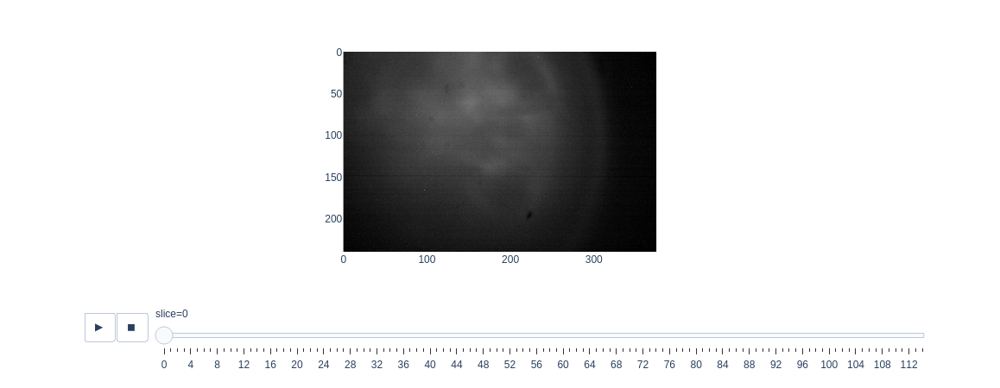

In [6]:
import plotly.express as px
from plotly.subplots import make_subplots
from skimage import io
data = io.imread("data/concat_may_NoRMCorre.tif")
img = data[25:140]
fig = make_subplots(1, 2)
fig = px.imshow(img, animation_frame=0, binary_string=True, labels=dict(animation_frame="slice"))
fig.show()


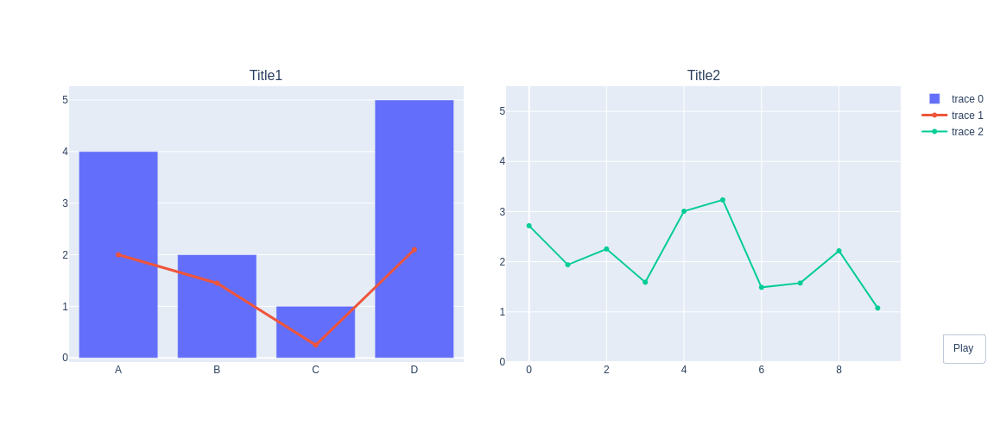

In [5]:
## HOW TO ADD 2 ANIMATIONS IN 2 SUBPLOTS:

import plotly.graph_objects as go
import numpy as np
from plotly.subplots import make_subplots

fig = make_subplots(
    rows=1, cols=2, subplot_titles=('Title1', 'Title2'),
    horizontal_spacing=0.051
)

fig.add_trace(go.Bar(x=['A', 'B', 'C', 'D'], y=[4, 2, 1, 5]), row=1, col=1) #this is the trace of index 0
fig.add_trace(go.Scatter(x=['A', 'B', 'C', 'D'], y=[2, 1.45, 0.25, 2.1],
                        line_width=3), row=1, col=1)   # trace of index 1

fig.add_trace(go.Scatter(x=np.arange(10),
                         y=1+3*np.random.rand(10),
                        marker_size=6), row=1, col=2)  #trace of index 2


#traces=[0, 1, 2]` in the frame definition makes the difference: it tells that 
#the traces of index 0, 1 from the subplot(1,1), are unchanged, and we only ensure their visibility in each #frame (because neither x nor y are modified)
#while the trace 2 from the subplot(1,2) is animated, because the y-values are changed. 

frames =[go.Frame(data=[go.Bar(visible=True),
                        go.Scatter(visible=True), ## NB: THIS HAS TO BE A CHANGING FRAME FOR THE VIDEO/HEATMAP
                        go.Scatter(y=2+3*np.random.rand(10))], ## NB: THIS HAS TO BE A CHANGING FRAME FOR THE LINECHART
                  traces=[0,1,2]) for k in range(20)]   # define 20 frames

fig.frames=frames
button = dict(
             label='Play',
             method='animate',
             args=[None, dict(frame=dict(duration=50, redraw=False), 
                              transition=dict(duration=0),
                              fromcurrent=True,
                              mode='immediate')])
fig.update_layout(updatemenus=[dict(type='buttons',
                              showactive=False,
                              y=0,
                              x=1.05,
                              xanchor='left',
                              yanchor='bottom',
                              buttons=[button] )
                                      ],
                 width=800, height=500)
                              
fig.update_layout(yaxis2_range=[0, 5.5], yaxis2_autorange=False)   